# Analyzing PBMCs single-cell data with TopOMetry


TopOMetry is intended for the topological analysis and visualization of high-dimensional data. In this notebook, I showcase how it can be used for the analysis of single-cell data, a challenging data modality which has been pushing representation learning to new frontiers. We'll be using a dataset containing around 6,000 individually RNA sequenced cells, consisting of peripherical blood mononuclear cells extracted from a healthy donor. 
To assist us throghout this analysis, we'll be using [scanpy](https://scanpy.readthedocs.io/en/latest/index.html), a scalable toolkit for analyzing single-cell RNA sequencing data. In particular, we'll use the _anndata_ framework for storing single-cell data and its plotting API for some plotting. 

## Install and load libraries

In [1]:
# Install pre-requisites and scanpy (pre-requisites for scanpy are python-igraph and leidenalg)
#!pip install nmslib annoy scipy scanpy numba kneed pymde python-igraph leidenalg scanpy 

In [2]:
# Install pre-release of TopOMetry
#!pip install -i https://test.pypi.org/simple/ topo

In [3]:
import numpy as np
import pandas as pd
import scanpy as sc
import pymde
import topo as tp

/usr/local/lib/python3.8/dist-packages/dask/config.py:161: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  data = yaml.load(f.read()) or {}


These are some scanpy helper functions:

In [4]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=60, dpi_save=300, facecolor='white')

scanpy==1.6.0 anndata==0.7.6 umap==0.4.6 numpy==1.18.5 scipy==1.5.3 pandas==1.1.3 scikit-learn==0.23.1 statsmodels==0.11.1 python-igraph==0.9.1 louvain==0.7.0 leidenalg==0.8.1


## Load data and QC

Download data from 10X genomics [website](https://support.10xgenomics.com/single-cell-gene-expression/datasets/6.0.0/SC3_v3_NextGem_DI_CellPlex_Human_PBMC_10K_PBMCs_human_1):

In [5]:
!mkdir data
!wget https://cf.10xgenomics.com/samples/cell-exp/6.0.0/SC3_v3_NextGem_DI_CellPlex_Human_PBMC_10K_PBMCs_human_1/SC3_v3_NextGem_DI_CellPlex_Human_PBMC_10K_PBMCs_human_1_count_sample_feature_bc_matrix.h5 -O data/SC3_v3_NextGem_DI_CellPlex_Human_PBMC_10K_PBMCs_human_1_count_sample_feature_bc_matrix.h5
!mkdir write

mkdir: cannot create directory ‘data’: File exists
--2021-05-11 21:43:42--  https://cf.10xgenomics.com/samples/cell-exp/6.0.0/SC3_v3_NextGem_DI_CellPlex_Human_PBMC_10K_PBMCs_human_1/SC3_v3_NextGem_DI_CellPlex_Human_PBMC_10K_PBMCs_human_1_count_sample_feature_bc_matrix.h5
Resolving cf.10xgenomics.com (cf.10xgenomics.com)... 2606:4700::6812:1ad, 2606:4700::6812:ad, 104.18.0.173, ...
Connecting to cf.10xgenomics.com (cf.10xgenomics.com)|2606:4700::6812:1ad|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 15239045 (15M) [binary/octet-stream]
Saving to: ‘data/SC3_v3_NextGem_DI_CellPlex_Human_PBMC_10K_PBMCs_human_1_count_sample_feature_bc_matrix.h5’

data/SC3_v3_NextGem 100%[===================>]  14.53M  6.05MB/s    in 2.4s    

2021-05-11 21:43:45 (6.05 MB/s) - ‘data/SC3_v3_NextGem_DI_CellPlex_Human_PBMC_10K_PBMCs_human_1_count_sample_feature_bc_matrix.h5’ saved [15239045/15239045]

mkdir: cannot create directory ‘write’: File exists


In [6]:
wd = '/home/davi/Documents/Bioinfo/pheno_tutorials/pbmc10k/'
results_file = 'write/pbmc10k.h5ad'  # the file that will store the analysis results

Read in the data with Scanpy:

In [7]:
adata = sc.read_10x_h5(
    'data/SC3_v3_NextGem_DI_CellPlex_Human_PBMC_10K_PBMCs_human_1_count_sample_feature_bc_matrix.h5')        
adata.var_names_make_unique()
adata                            

reading data/SC3_v3_NextGem_DI_CellPlex_Human_PBMC_10K_PBMCs_human_1_count_sample_feature_bc_matrix.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


 (0:00:00)


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


AnnData object with n_obs × n_vars = 6437 × 36601
    var: 'gene_ids', 'feature_types', 'genome'

This data contains 6,437 cells with 36,601 sequenced genes each. A great deal of this is just experimental noise, so we need to perform some quality control. Here, we'll do the default quality-control analysis:

filtered out 13 cells that have less than 200 genes expressed
filtered out 17855 genes that are detected in less than 3 cells


... storing 'feature_types' as categorical
... storing 'genome' as categorical


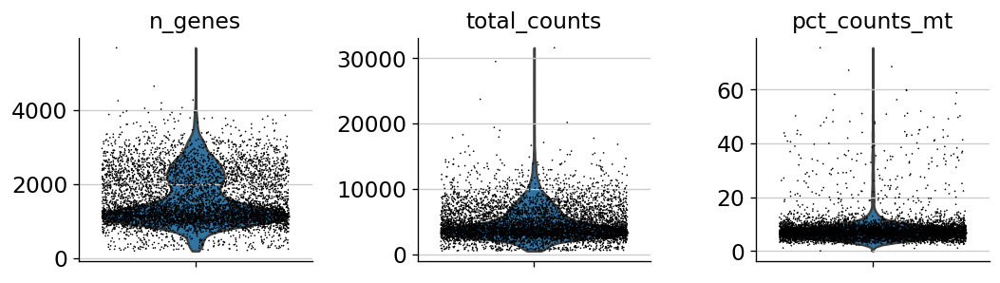

In [8]:
# Default QC
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
sc.pl.violin(adata, ['n_genes', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

Actually perform some filtering:

In [9]:
adata = adata[adata.obs.n_genes < 3000, :]
adata = adata[adata.obs.total_counts < 10000, :]
adata = adata[adata.obs.pct_counts_mt < 20, :]
adata

View of AnnData object with n_obs × n_vars = 5942 × 18746
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

## Default Scanpy workflow (PCA-based)

Here, for brevity sake, we'll perform the default scanpy workflow. For more information about the analysis of single-cell data and proposed workflows, we direct the interested user to [Scanpy tutorials](https://scanpy-tutorials.readthedocs.io/en/latest/index.html) and this [excellent best-practices review](https://www.embopress.org/doi/full/10.15252/msb.20188746). 

In short, this involves normalizing the library size of each sequenced cell by the total number of detected mRNA molecules, then logarithmizing it. Next, genes with high expression mean and high dispersion are selected as highly-variable genes, and stored for downstream analysis. Data is then scaled and mean-centered. 

The default workflow further involves computing PCA, and then using top principal components to compute a neighborhood graph. From this graph, it is possible to cluster cells with the leiden algorithm, and to obtain lower-dimensional embeddings with UMAP.

normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes


/home/davi/.local/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50


/home/davi/.local/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:806: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
running Leiden clustering
    finished: found 13 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:07)


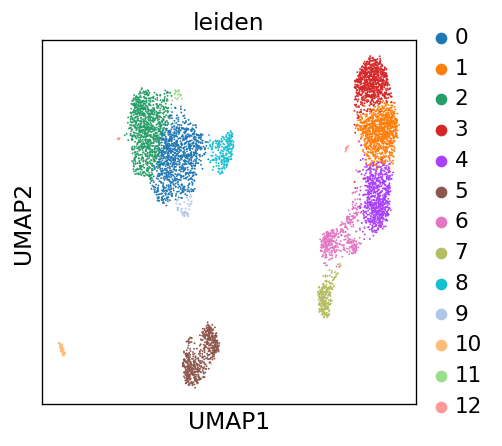

In [10]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, min_mean=0.125, max_mean=8, min_disp=0.3)
adata.raw = adata
adata = adata[:, adata.var.highly_variable]
sc.pp.scale(adata, max_value=10)
sc.tl.pca(adata)
sc.pp.neighbors(adata)
sc.tl.leiden(adata)
sc.tl.umap(adata)
sc.pl.embedding(adata, basis='umap', color=['leiden'], size=5)

This looks neat. Let's see how it compares to the TopOMetry workflow.

## Topological analysis with TopOMetry

Now that we have concluded the default Scanpy analysis, let's perform some topological analyses with TopOMetry. For this, we will start up a TopOGraph object with some data, and populate its slots as we proceed with the analysis. These 4 steps will be followed:

* Learn topological metrics - this can be done with diffusion harmonics or continuous k-nearest-neighbors (ckNN)
* Build a topological basis - this can be done with multiscale diffusion maps or a continuous Laplacian Eigenmap
* Extract a topological graph - again, this can be done with diffusion harmonics or ckNN
* Optimize a topological layout - this can be done with a Minimum Distortion Embedding or a Manifold Approximation and Projection

For now, let's start with the default TopOMetry analysis - using diffusion harmonics, multiscale maps and graphs.

### Fit a topological basis

In [11]:
# Convert the data - we'll use a csr_matrix, for speed
from scipy.sparse import csr_matrix
data = csr_matrix(adata.X) # scanpy stores the gene expression data at adata.X

Building topological basis...


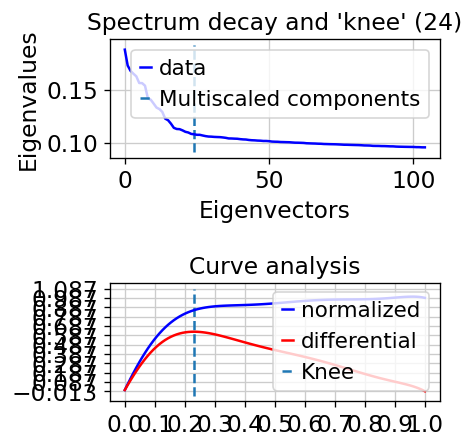

Topological basis fitted with diffusion mappings in 39.156711 (sec)


TopoGraph object with 5942 samples and 1338 observations and: 
    Diffusion basis fitted - .DiffBasis 
    Multiscale Diffusion Maps fitted - .MSDiffMap 
 Active basis: diffusion basis. 
 Active graph: diff graph.

In [12]:
# Start up the TopOGraph
tg = tp.models.TopOGraph(n_jobs=12, # set this to the highest number of available threads 
                         plot_spectrum=True)
tg.fit(data)

TopOMetry allows the user to visualize the dataset diffusion eigenspectrum when building multiscale diffusion maps. It automatically estimates the dataset dimensionality and selects and adequate number of diffusion components to scale and store for downstream analysis at `TopoGraph.MSDiffMap`. Users are also allowed to rescale the diffusion components to another number of components, if they want to obtain less or further detail on their dataset. As rule of thumb, more components lead to more detailed analyses, but can result in very disconnected embeddings. 

After re-scaling our multiscale diffusion maps, we'll add it to our `AnnData` object.

In [13]:
# Convenience function to re-scale to user's chosen number of components
tg.MSDiffMap = tg.DiffBasis.rescale(n_eigs=50)

# Add the multiscale diffusion maps to adata as a lower-dimensional representation
adata.obsm['X_ms_diff_map'] = tg.MSDiffMap

## Fit the topological graph


Let's take a look at our `TopOGraph` object:

In [14]:
tg

TopoGraph object with 5942 samples and 1338 observations and: 
    Diffusion basis fitted - .DiffBasis 
    Multiscale Diffusion Maps fitted - .MSDiffMap 
 Active basis: diffusion basis. 
 Active graph: diff graph.


After learning a topological basis, extracting an associated topological graph from the active basis is as simple as running `TopOGraph.transform()`. Note that the graph will be computed as per the `TopOGraph.graph` parameter (default `diff`, diffusion harmonics), on the specified `TopOGraph.basis` parameter (the active basis). 

In [15]:
db_diff_graph = tg.transform()

Building topological graph...
Topological graph extracted in = 0.235041 (sec)


## Optimize the topological graph layout

Now that we have learned a topological graph from our topological basis, we need to optimize its layout in order to visualize it. TopOMetry offers two options for that task:

 * MAP - Manifold Approximation and Projection, a generalized version of UMAP that does not hold the uniform distribution assumption. It's goal is to minimize the divergence between a given basis and a topological graph.
 * MDE - Minimum Distortion Embedding, a recently proposed dimensionality reduction method that generalized the problem of effective data visualization through convex optimization.

Naturally, you may perform visualization with any other method, such as t-SNE, PHATE or autoencoders, and still take advantage of TopOMetry by simply using the topological basis as input instead of raw data. Alternatively, if your chosen method takes as input a matrix of similarities, you can use the topological graph.

First, we'll perform layout optimization with the MAP approach:

Fuzzy layout optimization embedding in = 6.311060 (sec)


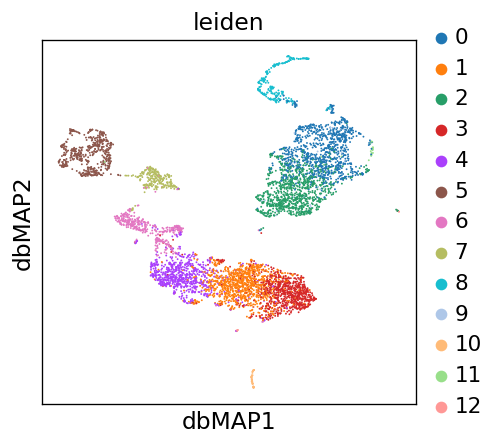

In [16]:
# Minimize divergence between the diffusion basis and diffusion graph
emb_dbmap, aux = tg.MAP(tg.MSDiffMap, db_diff_graph)

# Add learned embedding to adata
adata.obsm['X_dbMAP'] = emb_dbmap

# Plot with Scanpy
sc.pl.embedding(adata, basis='dbMAP', color=['leiden'], edges=False, size=5)

Next, we'll perform the layout optimization with pyMDE. This involves building a pyMDE graph from our topological graph (so to be compatible with pytorch), setting up an MDE problem, and effectively optimizing the embedding.

TopOMetry has pyMDE functions built-in in the `topo.lt` module. A separate tutorial exploring the wide array of options involved in MDE optimization is in the making. 

For now, let's run MDE with the default parameters:

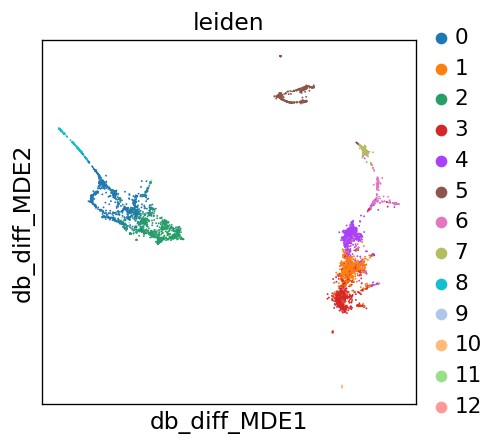

In [17]:
# Layout optimization with Minimum Distortion Embedding

# Set up MDE problem
db_diff_mde = tg.MDE(db_diff_graph, constraint=None)
db_diff_emb = db_diff_mde.embed(verbose=False, snapshot_every=1)

# Add to adata
adata.obsm['X_db_diff_MDE'] = db_diff_emb

# Plot with scanpy
sc.pl.embedding(adata, basis='db_diff_MDE', color=['leiden'], edges=False, size=5)

pyMDE allows us to visualize how data looks like during the optimization process:

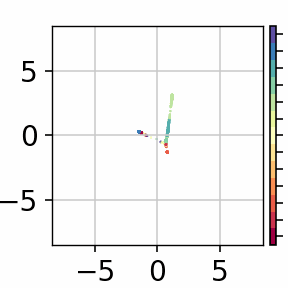

In [18]:
# Explore how data behaves during optimization
db_diff_mde.play(savepath= wd + 'pbmc10k_db_diff_MDE.gif',marker_size=2, color_by=adata.obs['leiden'],  figsize_inches=(2,2))

Let's now see what we have got inside the `tg` object storing our TopOGraph:

In [19]:
tg

TopoGraph object with 5942 samples and 1338 observations and: 
    Diffusion basis fitted - .DiffBasis 
    Multiscale Diffusion Maps fitted - .MSDiffMap 
    Diffusion graph fitted - .DiffGraph 
 Active basis: diffusion basis. 
 Active graph: diff graph.

### Exploring alternative topologies with TopOMetry

Now that we have explored some of data topology with the default TopOMetry analysis, we can also explore it under continuous nearest-neighbors topologies. We will explore the following combinations:

1 - Diffusion basis, diffusion graph (default, as we did above)

2 - Diffusion basis, continuous graph

3 - Continuous basis, diffusion graph

4 - Continuous basis, continuous graph

Although all these models render similar results, they give you, the end user, flexibility to find the better suited combination for your data. From our experience, the default combination tends to have more robust and significative results throghout a myriad of datasets, but you have a choice :)

Let's now try combination (2). Using our active basis, let's change our active graph model to cknn. 

In [20]:
tg.graph = 'cknn'
db_cknn_graph = tg.transform()

Building topological graph...
Topological graph extracted in = 0.915521 (sec)


Again, let's perform layout optimization with Minimum Distortion Embedding

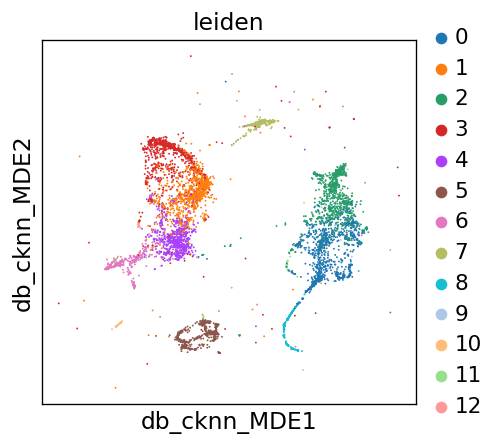

In [21]:
# Set up MDE problem
db_cknn_mde = tg.MDE(db_cknn_graph)
db_cknn_emb = db_cknn_mde.embed(verbose=False, snapshot_every=1)

# Add to adata
adata.obsm['X_db_cknn_MDE'] = db_cknn_emb

# Plot with scanpy
sc.pl.embedding(adata, basis='db_cknn_MDE', color=['leiden'], edges=False, size=5)

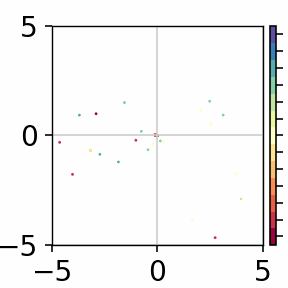

In [22]:
# Explore how data behaves during optimization
db_cknn_mde.play(savepath= wd + 'pbmc10k_db_cknn_MDE.gif',
         marker_size=2, color_by=adata.obs['leiden'], axis_limits=[-5, 5],  figsize_inches=(2,2))

As we can see, we still get more or less the same clusters distribution. However, we also see that this model is more sensitive to outliers, represented by the sparsely distributed cells without any relation to any cluster.

Now, let's explore how a continuous basis looks like. For that, we'll need to change the `basis` argument of our `tg` TopOGraph object, and fit the model once again. The previously computed diffusion basis is not lost in this process. 

Note that when computing a continuous basis, a continuous version of Laplacian Eigenmaps is used to embed the metric into latent dimensions. 

We'll start with combination (3), using a continuous basis and a diffusion graph.

In [23]:
tg.basis = 'continuous' 
tg.fit(data)
tg.graph = 'diff'
cb_diff_graph = tg.transform()

# Add the continuous Laplacian Eigenmaps to adata
adata.obsm['X_c_lapmap'] = tg.CLapMap

Building topological basis...


/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


Topological basis fitted with continuous mappings in 116.046612 (sec)
Building topological graph...
Topological graph extracted in = 0.289549 (sec)


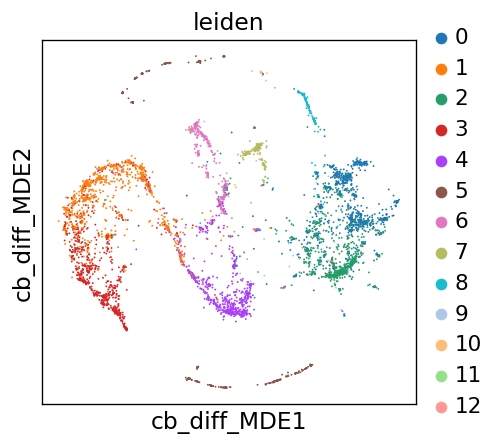

In [24]:
# Set up MDE problem
cb_diff_mde = tg.MDE(cb_diff_graph)
cb_diff_emb = cb_diff_mde.embed(verbose=False, snapshot_every=1)

# Add to adata
adata.obsm['X_cb_diff_MDE'] = cb_diff_emb

# Plot with scanpy
sc.pl.embedding(adata, basis='cb_diff_MDE', color=['leiden'], edges=False, size=5)

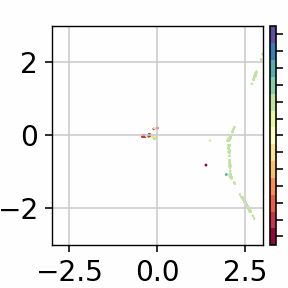

In [25]:
# Explore how data behaves during optimization
cb_diff_mde.play(savepath=wd + 'pbmc10k_cb_diff_MDE.gif',
         marker_size=2, color_by=adata.obs['leiden'], axis_limits=[-3, 3],  figsize_inches=(2,2))

Now let's go through with combination (4), using a continuous basis and a continuous graph. Because we have already fitted the continuous basis in our `tg` object, we only need to compute the graph.

Building topological graph...
Topological graph extracted in = 0.776618 (sec)


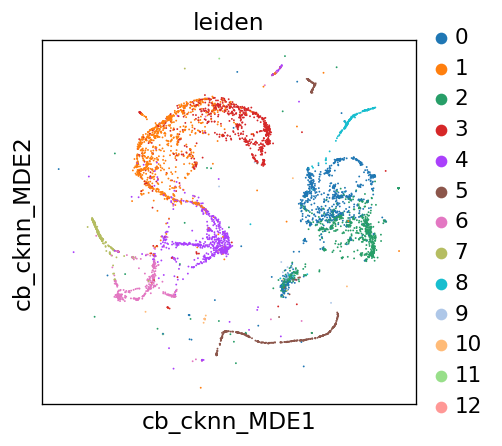

In [26]:
tg.graph = 'cknn'
cb_cknn_graph = tg.transform()

# Set up MDE problem
cb_cknn_mde = tg.MDE(cb_cknn_graph)
cb_cknn_emb = cb_cknn_mde.embed(verbose=False, snapshot_every=1)

# Add to adata
adata.obsm['X_cb_cknn_MDE'] = cb_cknn_emb

# Plot with scanpy
sc.pl.embedding(adata, basis='cb_cknn_MDE', color=['leiden'], edges=False, size=5)

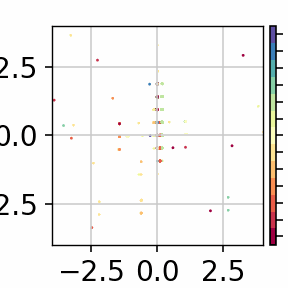

In [27]:
# Explore how data behaves during optimization
cb_cknn_mde.play(savepath=wd + 'pbmc10k_cb_cknn_MDE.gif',
         marker_size=2, color_by=adata.obs['leiden'], axis_limits=[-4, 4],  figsize_inches=(2,2))

Now that we have computed our results, let's look how our `tg` TopOGraph looks like!

In [28]:
tg

TopoGraph object with 5942 samples and 1338 observations and: 
    Diffusion basis fitted - .DiffBasis 
    Continuous basis fitted - .ContBasis 
    Multiscale Diffusion Maps fitted - .MSDiffMap 
    Continuous Laplacian Eigenmaps fitted - .CLapMap 
    Diffusion graph fitted - .DiffGraph 
    Continuous graph fitted - .CknnGraph 
 Active basis: continuous basis. 
 Active graph: cknn graph.

## Comparing the obtained embeddings

Cool! Now let's compare how our embeddings look like, and how the default clustering and some marker genes expressions are distributed.

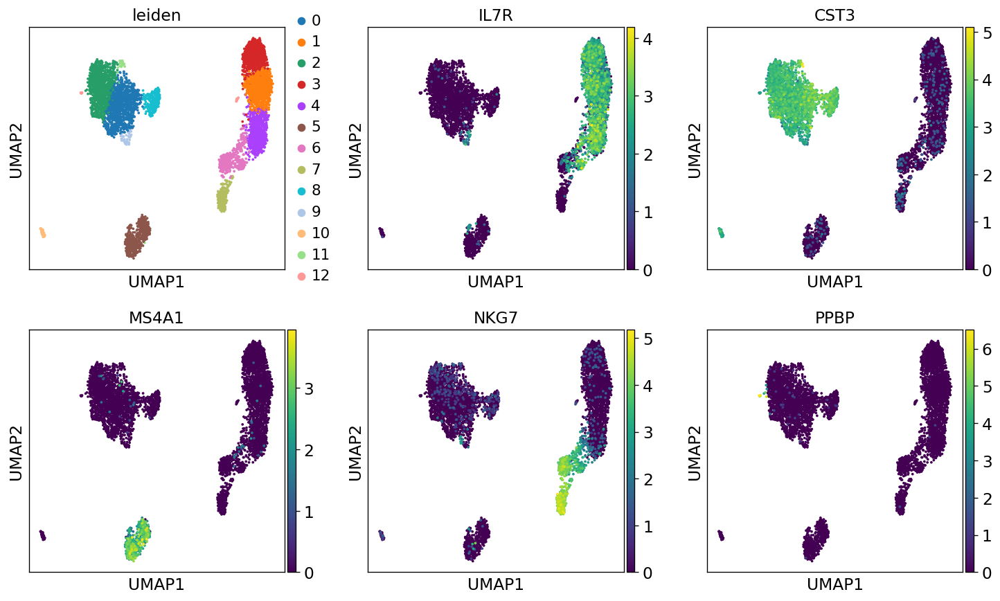

In [29]:
sc.pl.embedding(adata, basis='umap', color=['leiden', 'IL7R', 'CST3', 'MS4A1', 'NKG7','PPBP'], ncols=3)

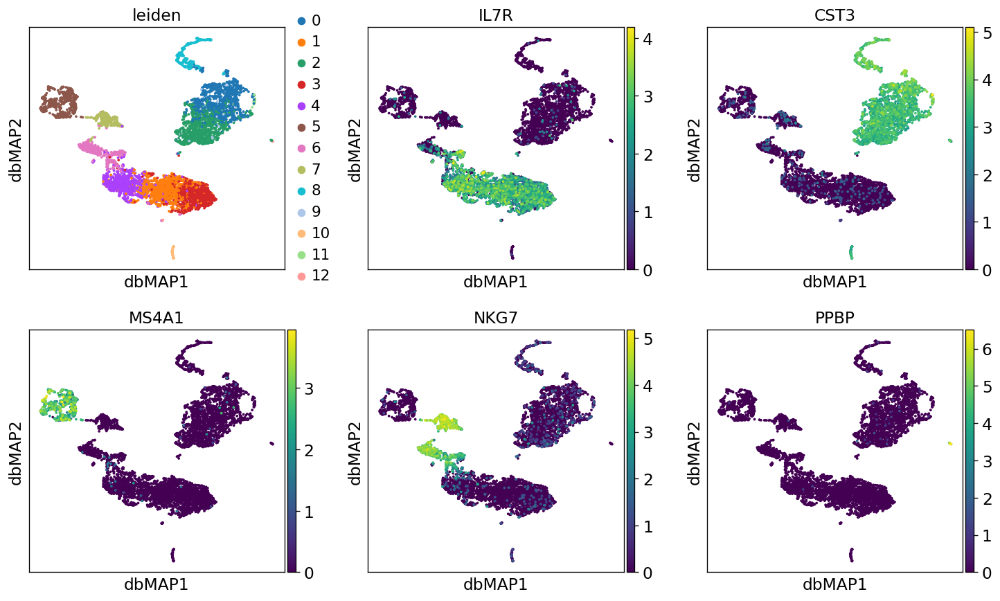

In [30]:
sc.pl.embedding(adata, basis='dbMAP', color=['leiden', 'IL7R', 'CST3', 'MS4A1', 'NKG7','PPBP'], ncols=3)

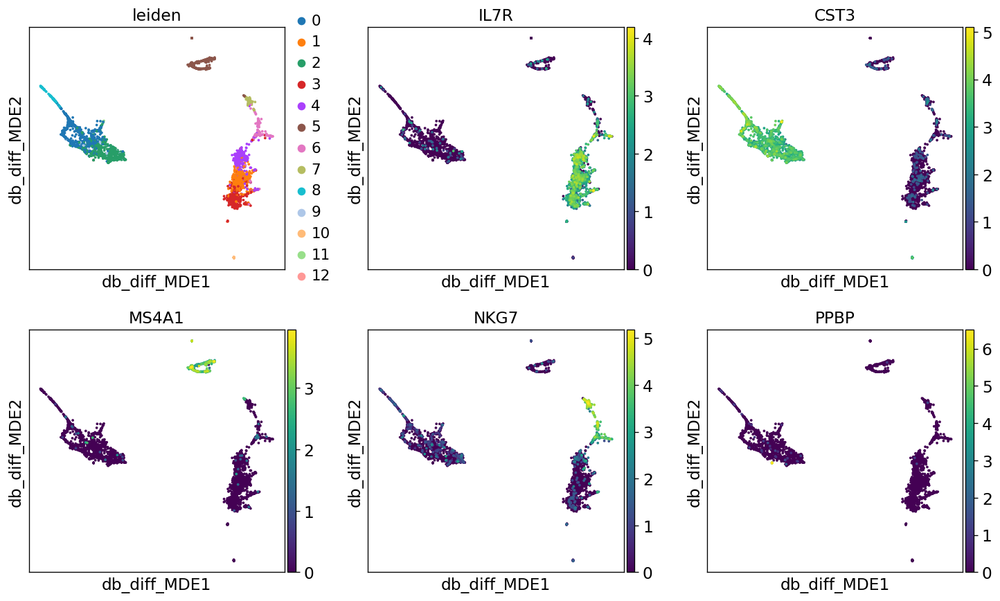

In [31]:
sc.pl.embedding(adata, basis='db_diff_MDE', color=['leiden', 'IL7R', 'CST3', 'MS4A1', 'NKG7','PPBP'], ncols=3)

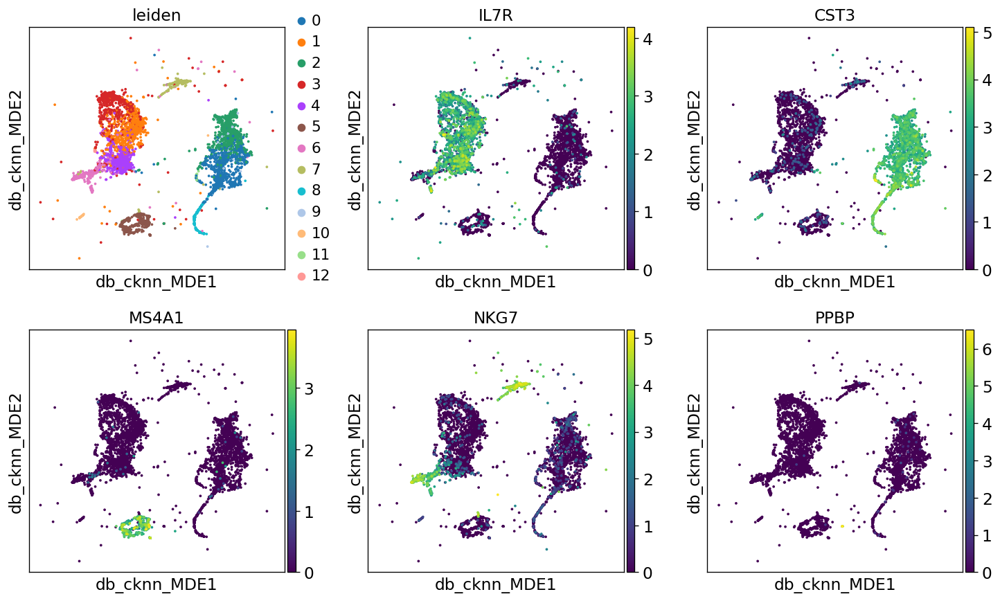

In [32]:
sc.pl.embedding(adata, basis='db_cknn_MDE', color=['leiden', 'IL7R', 'CST3', 'MS4A1', 'NKG7','PPBP'], ncols=3)

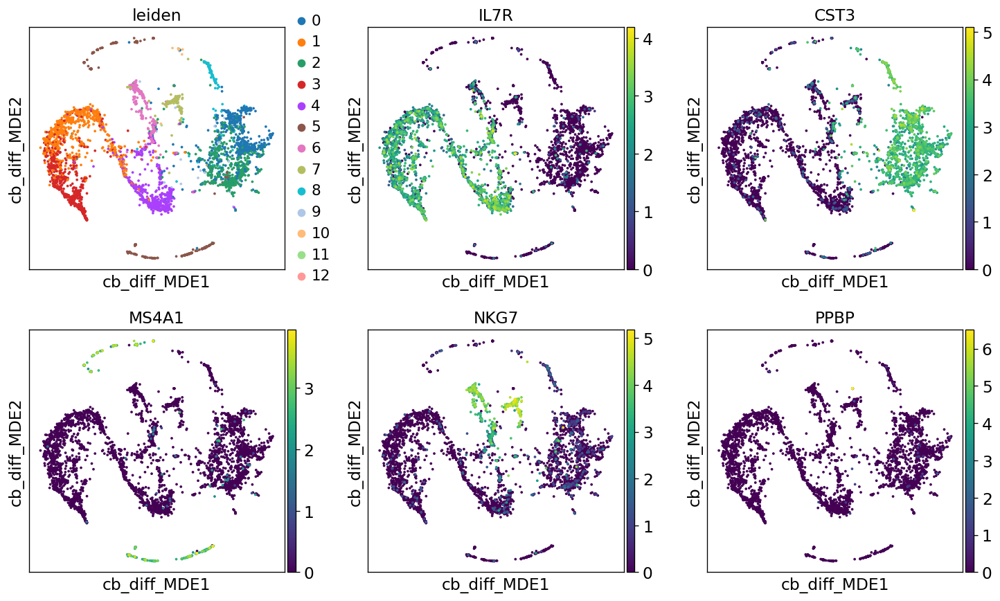

In [33]:
sc.pl.embedding(adata, basis='cb_diff_MDE', color=['leiden', 'IL7R', 'CST3', 'MS4A1', 'NKG7','PPBP'], ncols=3)

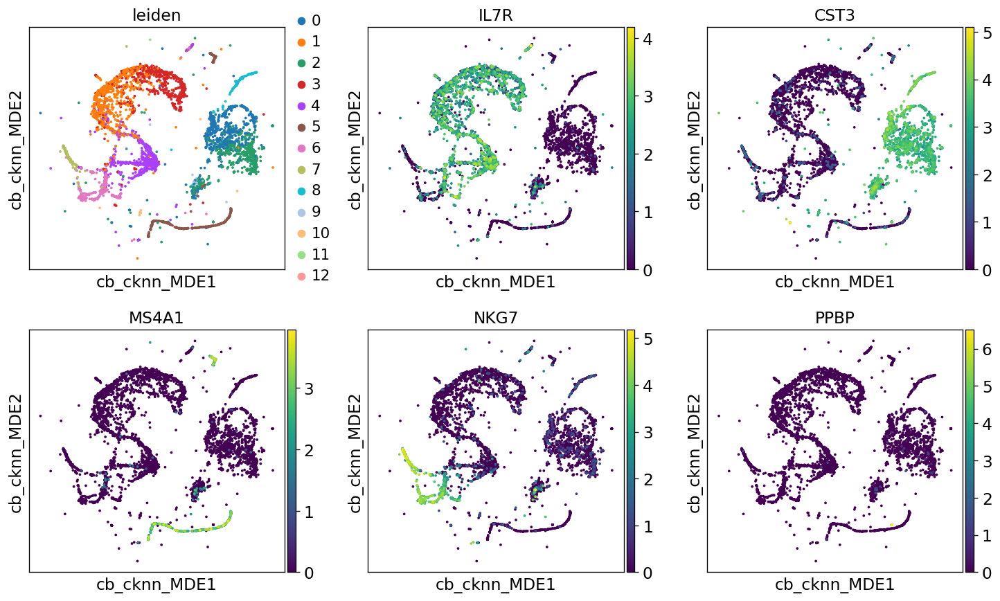

In [34]:
sc.pl.embedding(adata, basis='cb_cknn_MDE', color=['leiden', 'IL7R', 'CST3', 'MS4A1', 'NKG7','PPBP'], ncols=3)

## Re-clustering cells without the PCA basis

    Because of the computational expense involved in single-cell analysis, it is common-place for analysis toolkits to perform PCA as a preprocessing step. Neighborhoods (and clusters) are then computed from the PCA basis, which can be misleading when dealing with high-dimensional, non-linear data. 
    Here, we'll show how providing Scanpy with TopOMetry learned metrics can improve its clustering. For demonstration purposes, we'll use scanpy built-in leiden algorithm.
    First, let's add TopOMetry metrics to the `AnnData` object containing our single-cell data.
    

In [35]:
# Recall what's inside our `tg` TopOGraph
tg

TopoGraph object with 5942 samples and 1338 observations and: 
    Diffusion basis fitted - .DiffBasis 
    Continuous basis fitted - .ContBasis 
    Multiscale Diffusion Maps fitted - .MSDiffMap 
    Continuous Laplacian Eigenmaps fitted - .CLapMap 
    Diffusion graph fitted - .DiffGraph 
    Continuous graph fitted - .CknnGraph 
 Active basis: continuous basis. 
 Active graph: cknn graph.

In [36]:
# Store the PCA-derived clusters
adata.obs['pca_leiden'] = adata.obs['leiden']


# Compute clusters with the leiden algorithm using topological basis
sc.pp.neighbors(adata, use_rep='X_ms_diff_map') # MSDiffMap
sc.tl.leiden(adata, key_added='db_leiden')

sc.pp.neighbors(adata, use_rep='X_c_lapmap') #CLapMap
sc.tl.leiden(adata, key_added='cb_leiden')

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 21 clusters and added
    'db_leiden', the cluster labels (adata.obs, categorical) (0:00:00)
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 33 clusters and added
    'cb_leiden', the cluster labels (adata.obs, categorical) (0:00:00)


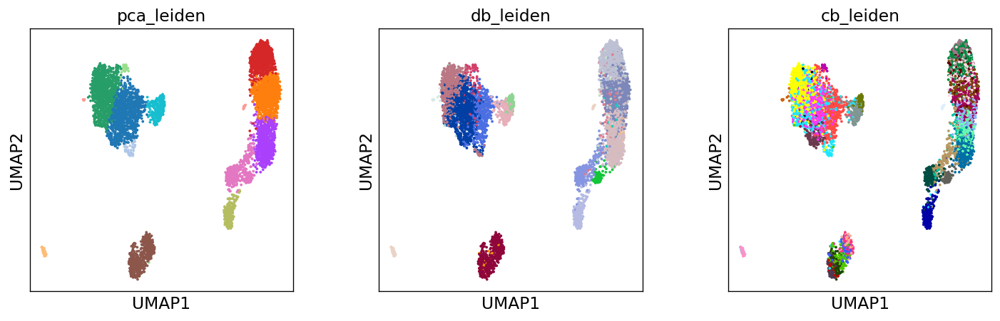

In [37]:
sc.pl.embedding(adata, basis='umap', color=['pca_leiden', 'db_leiden', 'cb_leiden'], legend_loc=None, ncols=3)

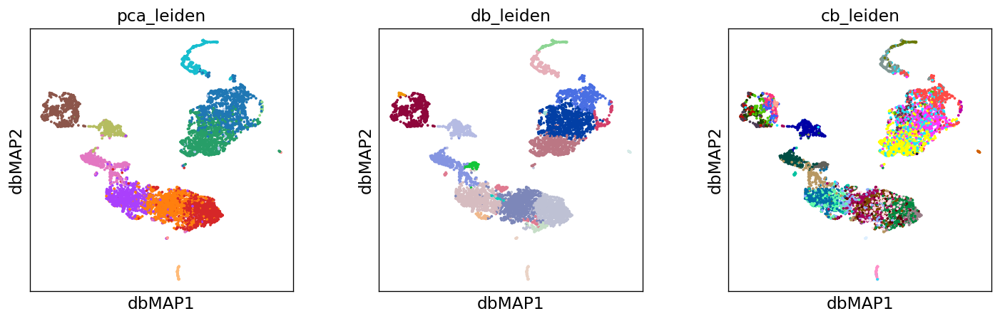

In [38]:
sc.pl.embedding(adata, basis='dbMAP', color=['pca_leiden', 'db_leiden', 'cb_leiden'], legend_loc=None, ncols=3)

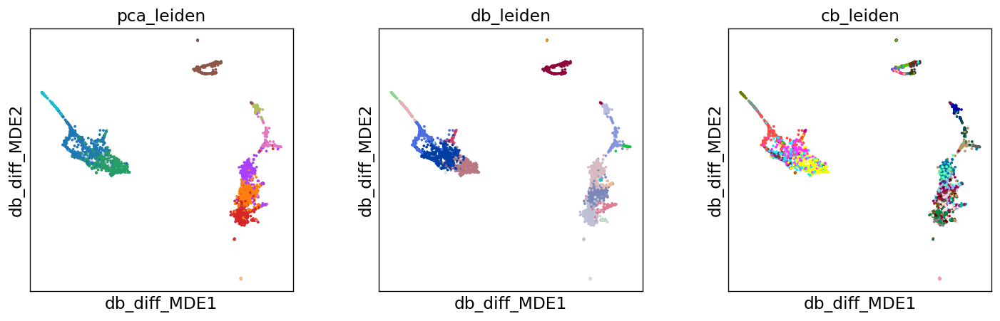

In [39]:
sc.pl.embedding(adata, basis='db_diff_MDE', color=['pca_leiden', 'db_leiden', 'cb_leiden'], legend_loc=None, ncols=3)

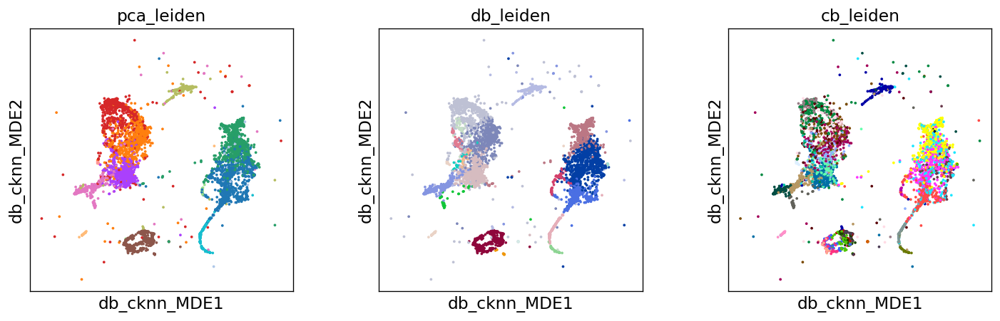

In [40]:
sc.pl.embedding(adata, basis='db_cknn_MDE', color=['pca_leiden', 'db_leiden', 'cb_leiden'], legend_loc=None, ncols=3)

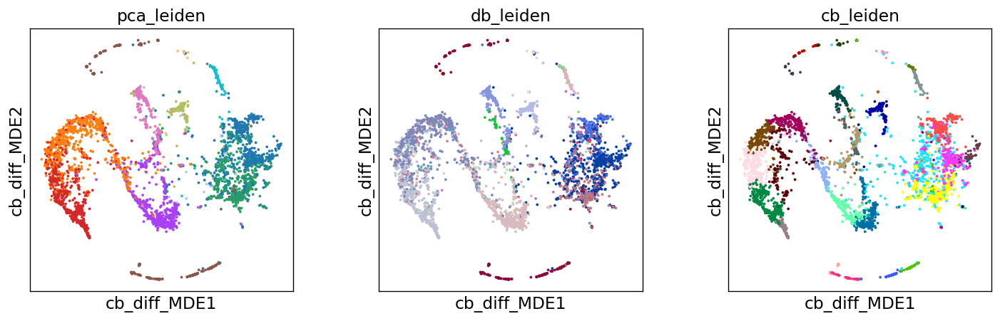

In [41]:
sc.pl.embedding(adata, basis='cb_diff_MDE', color=['pca_leiden', 'db_leiden', 'cb_leiden'], legend_loc=None, ncols=3)

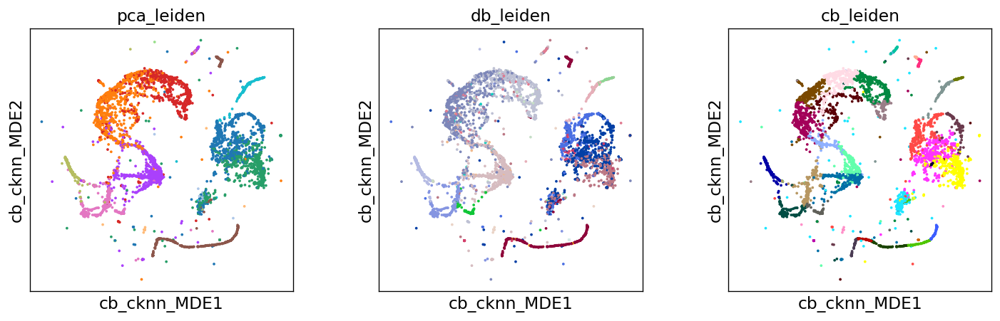

In [42]:
sc.pl.embedding(adata, basis='cb_cknn_MDE', color=['pca_leiden', 'db_leiden', 'cb_leiden'], legend_loc=None, ncols=3)

That's it for this tutorial! I hope you enjoyed and that TopOMetry might be useful for you!